In [1]:
import struct
import pandas as pd
import plotly
import plotly.graph_objs as go
import math

In [2]:
FLIGHT_MAP = {
    0: 'INVALID',
    1: 'MOVING',
    2: 'IDLE',
    3: 'THRUSTING_1',
    4: 'THRUSTING_2',
    5: 'COASTING',
    6: 'TRANSONIC_1',
    7: 'SUPERSONIC',
    8: 'TRANSONIC_2',
    9: 'APOGEE',
    10: 'PARACHUTE',
    11: 'BALLISTIC',
    12: 'TOUCHDOWN',
    0x7FFFFFFF: 'HEHE'
}

DROP_MAP = {
    0: 'INVALID',
    1: 'MOVING',
    2: 'IDLE',
    3: 'DROGUE CHUTE',
    4: 'MAIN CHUTE',
    0x7FFFFFFF: 'HEHE'
}

layout_font = dict(
            family="Courier New, monospace",
            size=12
        )

legend = dict(orientation="h", y = 1.13)

layout_args = dict(xaxis_title="Timestamp [s]",
        template= 'plotly_dark',
        legend=legend,
        font=layout_font,
        width=1500, height=800)

In [3]:
log = 'flight_logs/drop/drop_4.txt'
STATE_MAP = DROP_MAP

In [4]:
log_b = None
with open(log, 'r') as f:
    log_str = f.read()

log_str_formatted = log_str.replace('\r\n', ' ')
log_str_formatted = log_str_formatted.replace('\n', ' ')
log_str_formatted = log_str_formatted.replace('  ', ' ')
log_str_formatted = log_str_formatted.strip()

In [5]:
log_b = bytes.fromhex(log_str_formatted)

print(log_b[:20])

b'\x00\x04\x00\x00\x1f\xd0\x01\x00\x01\x00\x00\x00\x00\xa5\xa5\xa5\x00\x02\x00\x00'


In [6]:
imu = []
baro = []
flight_info = []
flight_states = []
covariance_info = []
sensor_info = []
event_info = []
i = 0
first_ts = -1
last_ts = -1
try:
    while i < len(log_b):
        t = struct.unpack('<L', log_b[i:i+4])[0]
        i += 4
        if t in [1, 2, 4]:
            ts, gyro_x, gyro_y, gyro_z, acc_x, acc_y, acc_z = struct.unpack('<Lhhhhhh', log_b[i: i+16])
            if first_ts == -1:
                first_ts = ts
            #print(f"{ts} IMU {t-1}: Gx: {gyro_x}, Gy: {gyro_y}, Gz: {gyro_z}, Ax: {acc_x}, Ay: {acc_y}, Az: {acc_z}")
            imu.append({'ts': ts / 1000,
                        'id': f'IMU{int(math.log2(t)) - int(math.log2(1))}',
                        'Gx': gyro_x / 16.4,
                        'Gy': gyro_y / 16.4,
                        'Gz': gyro_z / 16.4,
                        'Ax': acc_x / 1024,
                        'Ay': acc_y / 1024,
                        'Az': acc_z / 1024})
            #print(imu_data)
            i += 4 + 6 + 6 #ts + 6 x int16
        elif t in [8, 16, 32]:
            ts, pressure, temperature = struct.unpack('<LLL', log_b[i: i+12])
            if first_ts == -1:
                first_ts = ts
            #print(f"{ts} BARO {t-4}: P: {pressure}, T: {temperature}")
            baro.append({'ts': ts / 1000,
                         'id': f'BARO{int(math.log2(t)) - int(math.log2(8))}',
                         'T': temperature / 100,
                         'P': pressure})
            #print(baro_data)
            i += 4 + 4 + 4
        elif t == 64:
            ts, height, velocity, acceleration, altitude_agl = struct.unpack('<Lffff', log_b[i: i+20])
            if first_ts == -1:
                first_ts = ts
            #print(f"{ts} FLIGHT_INFO: Height: {height}, Velocity: {velocity}, Acc: {acceleration}")
            flight_info.append({'ts': ts / 1000,
                                'height': height,
                                'velocity': velocity,
                                'acceleration': acceleration,
                                'altitude_agl': altitude_agl})
            #print(flight_info_data)
            i += 4 + 4 + 4 + 4 + 4
        elif t == 128:
            #print("FLIGHT_STATE")
            ts, state = struct.unpack('<LL', log_b[i: i+8])
            if first_ts == -1:
                first_ts = ts
            flight_states.append({'ts': ts / 1000, 'state': state})
            #print(f"{ts} FLIGHT STATE: State: {state}")
            i += 4 + 4
        elif t == 256:
            ts, height_cov, velocity_cov = struct.unpack('<Lff', log_b[i: i+12])
            if first_ts == -1:
                first_ts = ts
            #print(f"{ts} COVARIANCE_INFO: Height cov: {height_cov}, Velocity cov: {velocity_cov}")
            covariance_info.append({'ts': ts / 1000,
                                    'height_cov': height_cov,
                                    'velocity_cov': velocity_cov})
            #print(flight_info_data)
            i += 4 + 4 + 4
        elif t == 512:
            #print(f"Sensor info found at {i}")
            ts, imu_0, imu_1, imu_2, baro_0, baro_1, baro_2 = struct.unpack('<LBBBBBB', log_b[i: i+10])
            if first_ts == -1:
                first_ts = ts
            sensor_info.append({'ts': ts / 1000,
                                    'imu_0': imu_0,
                                    'imu_1': imu_1,
                                    'imu_2': imu_2,
                                    'baro_0': baro_0, 'baro_1': baro_1, 'baro_2': baro_2})
            i += 4 + 6 + 2 # +2 is because of the padding
        elif t == 1024:
            #print(f"Event info found at {i}")
            ts, event, out_idx = struct.unpack('<LLB', log_b[i: i+9])
            if first_ts == -1:
                first_ts = ts
            event_info.append({'ts': ts / 1000,
                                    'event': event,
                                    'out_idx': out_idx})
            i += 4 + 4 + 1 + 3 # +3 is because of the padding
        else:
            print(t)
            print(f"ERROR at {i}")
            break
        last_ts = ts
except Exception as e:
    print(f'Parsing ended with error: {e}')
finally:
    print(f'Parsing ended at position: {i}\nFirst timestamp: {first_ts / 1000}s; Last timestamp: {last_ts/1000}s\n')

Parsing ended with error: unpack requires a buffer of 12 bytes
Parsing ended at position: 1537532
First timestamp: 118.815s; Last timestamp: 212.622s



In [7]:
flight_states

[{'ts': 128.297, 'state': 3}, {'ts': 146.307, 'state': 4}]

In [8]:
event_info

[{'ts': 118.815, 'event': 1, 'out_idx': 0},
 {'ts': 128.295, 'event': 4, 'out_idx': 0},
 {'ts': 128.299, 'event': 4, 'out_idx': 1},
 {'ts': 129.301, 'event': 4, 'out_idx': 2},
 {'ts': 146.305, 'event': 5, 'out_idx': 0},
 {'ts': 146.309, 'event': 5, 'out_idx': 1}]

In [9]:
for state in flight_states:
    print(f"{state['ts']} -- {STATE_MAP[state['state']]}")

128.297 -- DROGUE CHUTE
146.307 -- MAIN CHUTE


In [10]:
def add_flight_states(fig, flight_states):
    for state in flight_states:
        fig.add_vline(x=state['ts'], line_width=1, line_dash="dash", line_color="green", annotation_text=STATE_MAP[state['state']])

In [11]:
def plot_imu_data(imu_df, flight_states, ret = False):
    fig_ax = go.Figure()
    fig_ay = go.Figure()
    fig_az = go.Figure()
    fig_gx = go.Figure()
    fig_gy = go.Figure()
    fig_gz = go.Figure()
    for imu_id, one_imu in imu_df.groupby('id'):
        fig_ax.add_scatter(x=one_imu.ts, y=one_imu.Ax, name=imu_id, mode='lines')
        fig_ay.add_scatter(x=one_imu.ts, y=one_imu.Ay, name=imu_id, mode='lines')
        fig_az.add_scatter(x=one_imu.ts, y=one_imu.Az, name=imu_id, mode='lines')
        fig_gx.add_scatter(x=one_imu.ts, y=one_imu.Gx, name=imu_id, mode='lines')
        fig_gy.add_scatter(x=one_imu.ts, y=one_imu.Gy, name=imu_id, mode='lines')
        fig_gz.add_scatter(x=one_imu.ts, y=one_imu.Gz, name=imu_id, mode='lines')
    
    add_flight_states(fig_ax, flight_states)
    add_flight_states(fig_ay, flight_states)
    add_flight_states(fig_az, flight_states)
    add_flight_states(fig_gx, flight_states)
    add_flight_states(fig_gy, flight_states)
    add_flight_states(fig_gz, flight_states)
    
    fig_ax.update_layout(
        title="IMU Acc_x",
        yaxis_title="Acc_x [g]",
        legend_title="IMU ID",
        **layout_args
    )
    
    fig_ay.update_layout(
        title="IMU Acc_y",
        yaxis_title="Acc_y [g]",
        legend_title="IMU ID",
        **layout_args
    )
        
    fig_az.update_layout(
        title="IMU Acc_z",
        yaxis_title="Acc_z [g]",
        legend_title="IMU ID",
        **layout_args
    )
    
    fig_gx.update_layout(
        title="IMU Gyro_x",
        yaxis_title="Gyro_x [dps]",
        legend_title="IMU ID",
        **layout_args
    )
    
    fig_gy.update_layout(
        title="IMU Gyro_y",
        yaxis_title="Gyro_y [dps]",
        legend_title="IMU ID",
        **layout_args
    )
        
    fig_gz.update_layout(
        title="IMU Gyro_z",
        yaxis_title="Gyro_z [dps]",
        legend_title="IMU ID",
        **layout_args
    )
           
    if ret: 
        return [fig_ax, fig_ay, fig_az, fig_gx, fig_gy, fig_gz]
    else:
        fig_ax.show()
        fig_ay.show()
        fig_az.show()
        fig_gx.show()
        fig_gy.show()
        fig_gz.show()
        return None

In [12]:
def plot_baro_data(baro_df, flight_states, ret = False):
    fig_temp = go.Figure()
    fig_press = go.Figure()
    for baro_id, one_baro in baro_df.groupby('id'):
        fig_temp.add_scatter(x=one_baro.ts, y=one_baro['T'], name=baro_id, mode='lines')
        fig_press.add_scatter(x=one_baro.ts, y=one_baro['P'], name=baro_id, mode='lines')
    
    add_flight_states(fig_temp, flight_states)
    add_flight_states(fig_press, flight_states)
    
    deg = u'\N{DEGREE SIGN}'
    fig_temp.update_layout(
        title="BARO Temperature",
        yaxis_title=f"T [{deg}C]",
        legend_title="BARO ID",
        **layout_args
    )
    
    fig_press.update_layout(
        title="BARO Pressure",
        yaxis_title="P [hPa]",
        legend_title="BARO ID",
        **layout_args
    )
    
    if ret: 
        return [fig_temp, fig_press]
    else:
        fig_temp.show()
        fig_press.show()
        return None    

In [13]:
def plot_flight_info(flight_info_df, flight_states, ret = False):
    fig_height = go.Figure()
    fig_vel = go.Figure()
    fig_acc = go.Figure()
    
    fig_only_agl = go.Figure()
    
    fig_height.add_scatter(x=flight_info_df.ts, y=flight_info_df['height'], name="height", mode='lines')
    fig_height.add_scatter(x=flight_info_df.ts, y=flight_info_df['lower_bound'], name="lower_bound", mode='lines')
    fig_height.add_scatter(x=flight_info_df.ts, y=flight_info_df['upper_bound'], name="upper_bound", mode='lines')
    fig_height.add_scatter(x=flight_info_df.ts, y=flight_info_df['altitude_agl'], name="altitude_agl", mode='lines')
    
    fig_only_agl.add_scatter(x=flight_info_df.ts, y=flight_info_df['altitude_agl'], name="altitude_agl", mode='lines')
    
    fig_vel.add_scatter(x=flight_info_df.ts, y=flight_info_df['velocity'], name="velocity", mode='lines')
    
    fig_acc.add_scatter(x=flight_info_df.ts, y=flight_info_df['acceleration'], name="acceleration", mode='lines')
    
    add_flight_states(fig_only_agl, flight_states)
    
    add_flight_states(fig_height, flight_states)
    add_flight_states(fig_vel, flight_states)
    add_flight_states(fig_acc, flight_states)
    
    fig_only_agl.update_layout(
        title="Altitude Above Ground Level",
        yaxis_title="Height [m]",
        **layout_args
    )
    
    fig_height.update_layout(
        title="Height",
        yaxis_title="Height [m]",
        **layout_args
    )
    
    fig_vel.update_layout(
        title="Velocity",
        yaxis_title="Velocity [m/s]",
        **layout_args
    )
    
    squared = u'\N{SUPERSCRIPT TWO}'
    fig_acc.update_layout(
        title="Acceleration",
        yaxis_title=f"Acceleration [m/s{squared}]",
        **layout_args
        )
    if ret: 
        return [fig_only_agl]
    else:
        fig_height.show()    
        fig_vel.show() 
        fig_acc.show()
        return None

In [14]:
imu_df = pd.DataFrame(imu)
baro_df = pd.DataFrame(baro)

flight_info_df = pd.DataFrame(flight_info)
covariance_df = pd.DataFrame(covariance_info)
#lower_bound = flight_info_df.height + 3*(covariance_df.height_cov)**0.5]
flight_info_df['lower_bound'] = flight_info_df.height + 3*(covariance_df.height_cov)**0.5
flight_info_df['upper_bound'] = flight_info_df.height - 3*(covariance_df.height_cov)**0.5

sensor_info_df = pd.DataFrame(sensor_info)

In [15]:
def figures_to_html(imu_plots, baro_plots, state_plots, filename):
    '''Saves a list of plotly figures in an html file.'''
    import plotly.offline as pyo

    dashboard = open(filename, 'w')
    head = """<html><head>
    <style>
        body {background-color: black;}
        div  {display: inline-block;margin: 5px; padding:5px;}
        h1 {font-size: 3em; color: floralwhite; font-family: 'Courier New', monospace}
        h2 {font-size: 2em; color: floralwhite; font-family: 'Courier New', monospace}
        .container { white-space: nowrap; }
    </style>
    </head><body><center>\n"""
    dashboard.write(head)
    
#         span {
#             float: left;
#             white-space:nowrap;
#         }
    
    dashboard.write('<h1>IMU Data - Acceleration</h1>')
    #dashboard.write('<h1>IMU Data - Acceleration</h1><div class="container">')
    
    add_js = True
    xyz='XYZ'
    i = 0
    for fig in imu_plots[:3]:
        inner_html = pyo.plot(
            fig, include_plotlyjs=add_js, output_type='div'
        )
        dashboard.write(f'<h2>Acc {xyz[i]}</h2><div class="container">')
        dashboard.write(inner_html)
        dashboard.write('</div>')
        add_js = False
        i += 1
        
    dashboard.write('<br/>')
    
    i = 0
    dashboard.write('<h1>IMU Data - Gyros</h1>')
    for fig in imu_plots[3:]:
        inner_html = pyo.plot(
            fig, include_plotlyjs=add_js, output_type='div'
        )
        dashboard.write(f'<h2>Gyro {xyz[i]}</h2><div class="container">')
        dashboard.write(inner_html)
        dashboard.write('</div>')
        add_js = False
        i += 1
        
    dashboard.write('<br/>')
    
    
    dashboard.write('<h1>Barometer Data</h1>')
    xyz = ['Temperature', 'Pressure']
    i = 0
    for fig in baro_plots:
        inner_html = pyo.plot(
            fig, include_plotlyjs=add_js, output_type='div'
        )
        dashboard.write(f'<h2>{xyz[i]}</h2><div class="container">')
        dashboard.write(inner_html)
        dashboard.write('</div>')
        add_js = False
        i += 1
        
    dashboard.write('<br/>')
    
    dashboard.write('<h1>State Estimation Data</h1>')
    
    xyz = ['AGL Altitude']
    i = 0
    for fig in state_plots:
        inner_html = pyo.plot(
            fig, include_plotlyjs=add_js, output_type='div'
        )
        dashboard.write(f'<h2>{xyz[i]}</h2><div class="container">')
        dashboard.write(inner_html)
        dashboard.write('</div>')
        add_js = False
        i += 1
        
    dashboard.write('<br/>')
    
    
    dashboard.write("</center></body></html>" + "\n")

In [16]:
imu_plots = plot_imu_data(imu_df, flight_states, True)
baro_plots = plot_baro_data(baro_df, flight_states, True)
state_plots = plot_flight_info(flight_info_df, flight_states, True)

In [17]:
out_name = log.split('/')[-1].split('.')[0]
figures_to_html(imu_plots, baro_plots, state_plots, f'{out_name} - plots.html')

In [18]:
# imu_df.to_csv("flight_logs/drop/output/imu.csv")
# baro_df.to_csv("flight_logs/drop/output/baro.csv")
# flight_info_df[['ts','altitude_agl']].to_csv("flight_logs/drop/output/altitude_agl.csv")

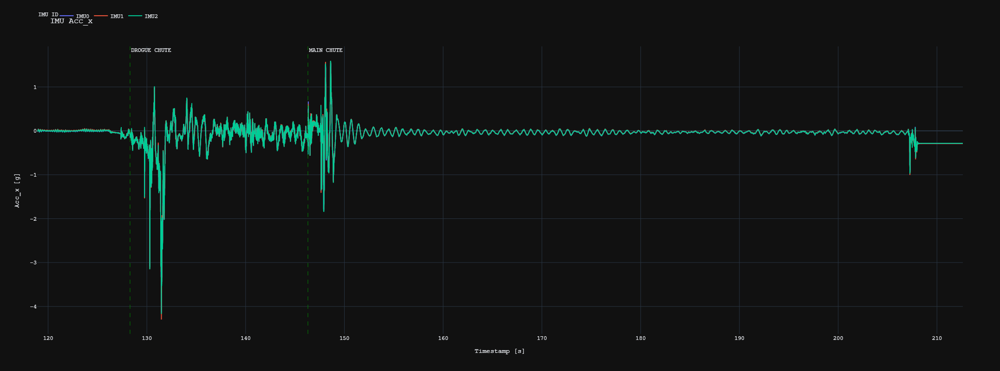

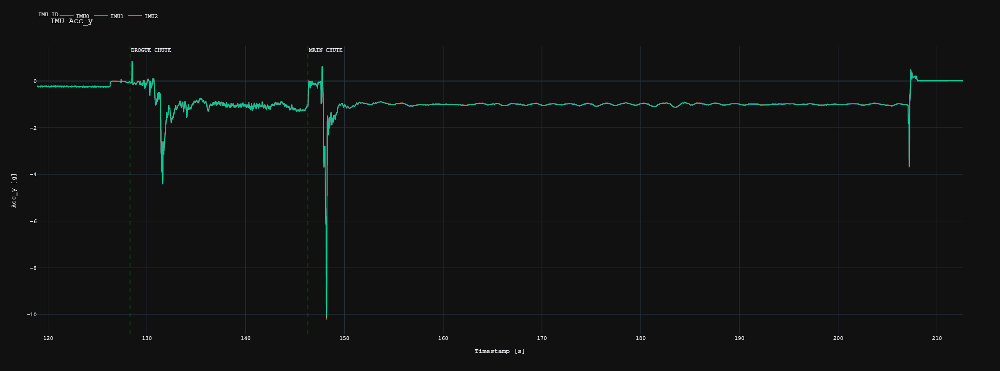

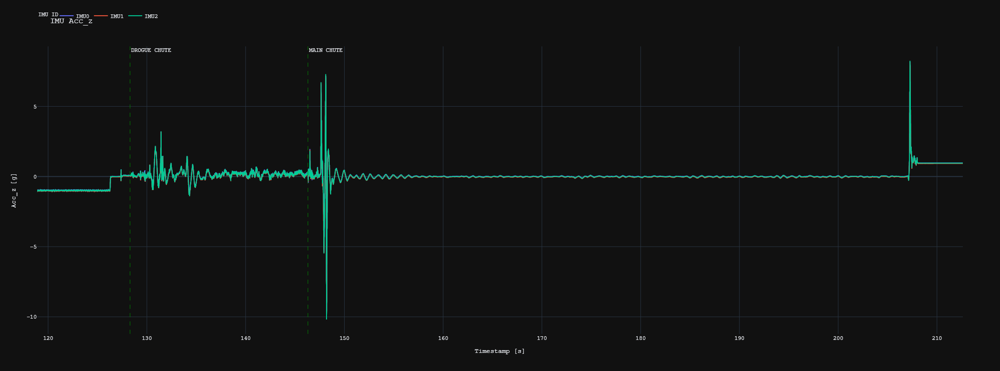

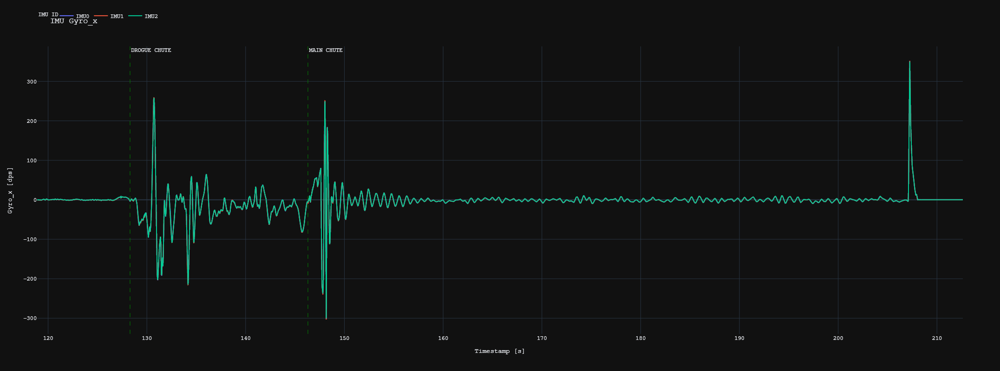

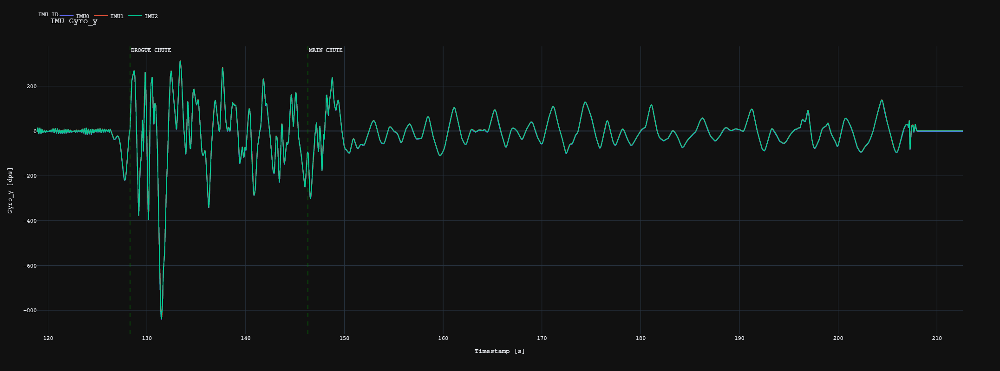

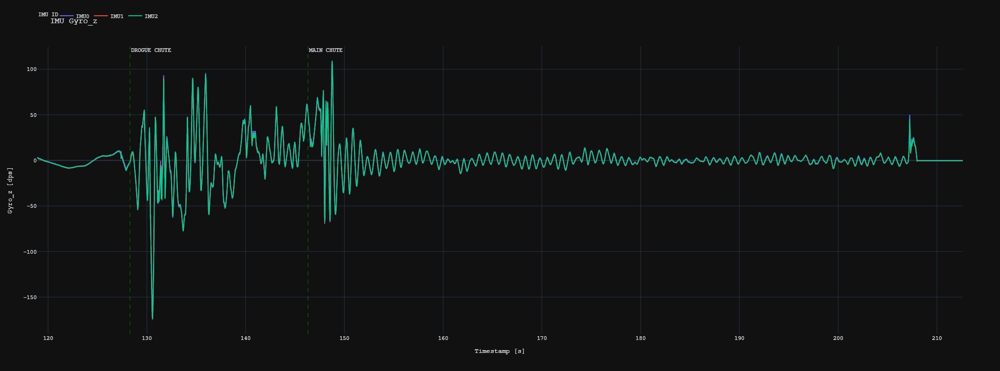

In [19]:
plot_imu_data(imu_df, flight_states)

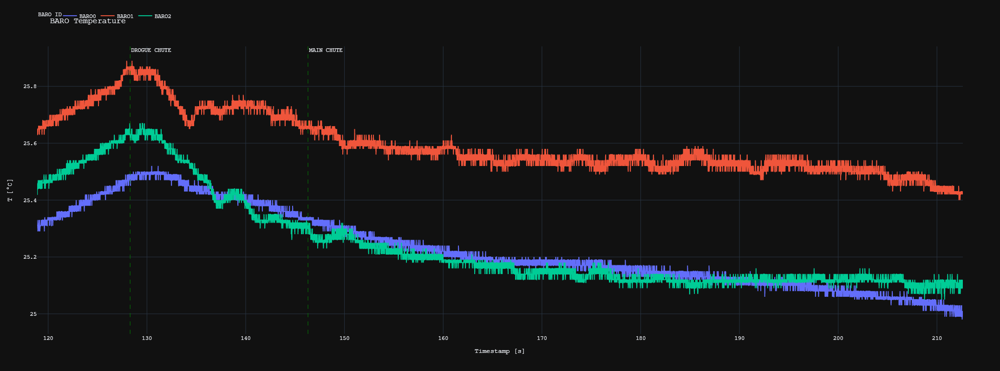

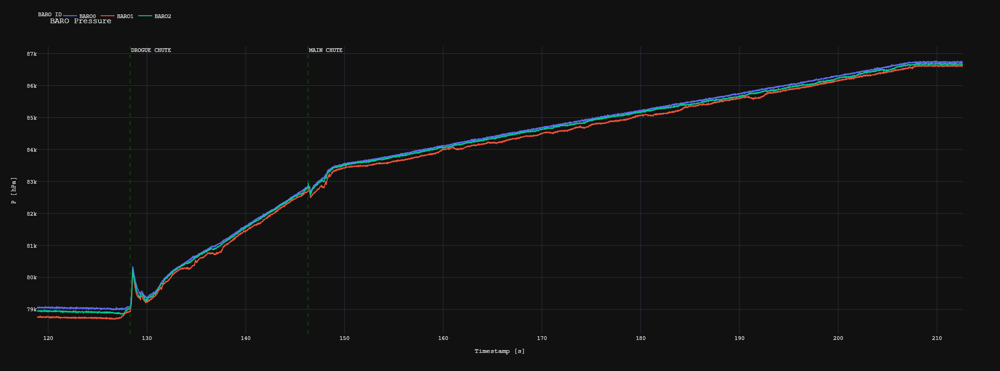

In [20]:
plot_baro_data(baro_df, flight_states)

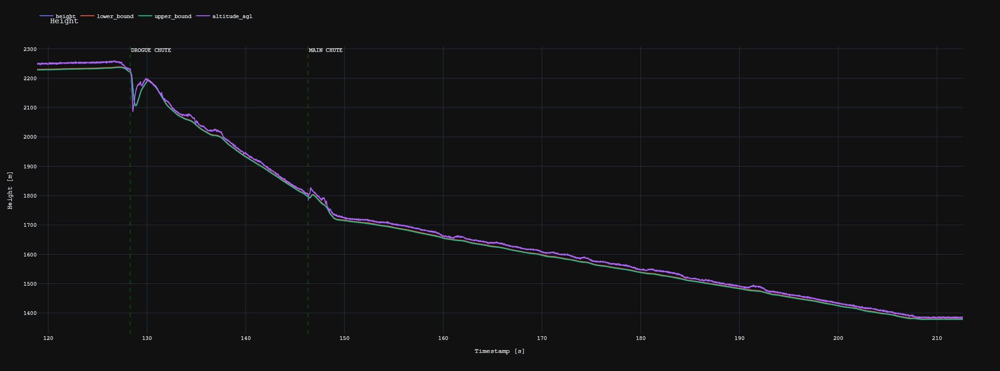

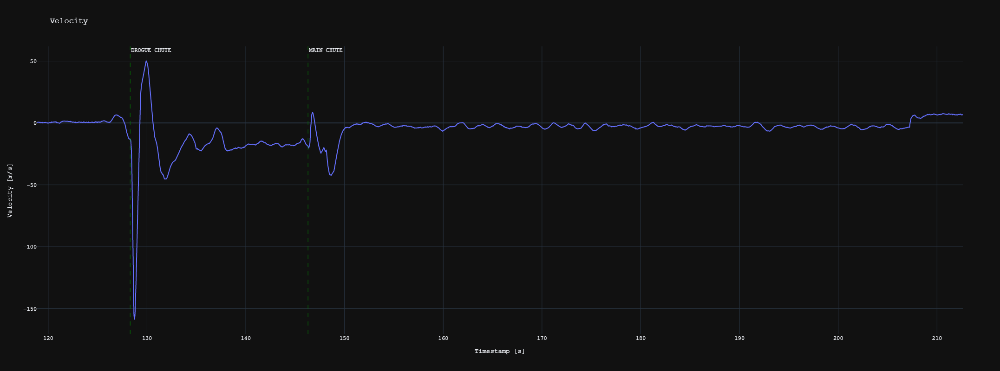

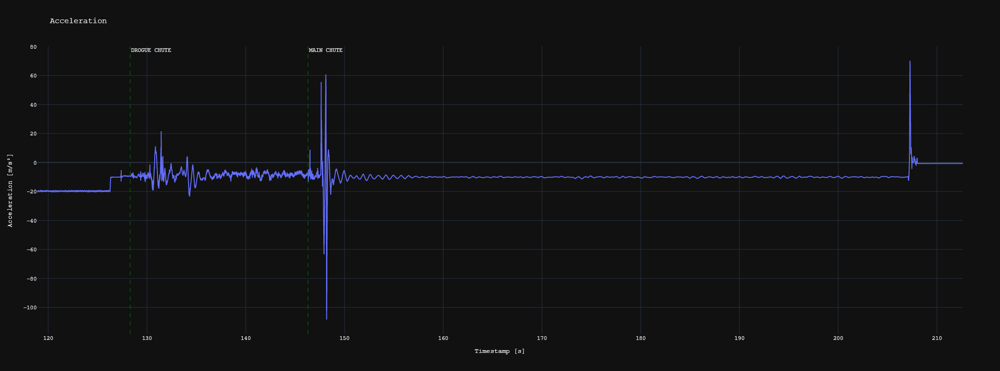

In [21]:
plot_flight_info(flight_info_df, flight_states)

In [22]:
sensor_info_df

,ts,imu_0,imu_1,imu_2,baro_0,baro_1,baro_2
0,118.879,0,0,0,0,0,0
1,118.889,0,0,0,0,0,0
2,118.899,0,0,0,0,0,0
3,118.909,0,0,0,0,0,0
4,118.919,0,0,0,0,0,0
...,...,...,...,...,...,...,...
9370,212.579,0,0,0,0,0,0
9371,212.589,0,0,0,0,0,0
9372,212.599,0,0,0,0,0,0
9373,212.609,0,0,0,0,0,0
